# Introduction
## *Berlin - a city to live... but where?*
<img src="Brandenburger_Tor_Berlin_at_night.jpg" width=400 />
Berlin is not only the capital city of Germany it is also a city with an interesting history. After the splitting into 4 sectors by the end of the Second World War, the Berlin Wall (construction began on 13 August 1961) was later built as a symbol of the great differences between the East and West powers and of the Cold War. With the fall of the Berlin Wall (November 9, 1989) the reunion of East and West was initiated. And after the German reunification of the GDR and the Federal Republic of Germany (on October 3, 1990), Berlin was simultaneously named the capital city of the Federal Republic of Germany. Today Berlin is a city with many different aspects in art, culture, politics, technology and science. With about 3.7 million inhabitants and an area of about 892 square kilometres, it is the largest city in Germany. With many inhabitants, however, aspects such as crime and its influence on normal city life are becoming increasingly important. The question that arises is therefore: *"Is it possible to discover safe and yet attractive and lively areas of the city based on data?"*

# Data and Data Processing
Nowadays, information defines our everyday life. But can they also help us to make decisions that are related to everyday situations? What about moving to a foreign city, for example. Where should you settle down? What are the localities? How do I get around? And above all, am I safe? All these factors can have a strong influence on our decision where to settle down. In the following sections I have tried, taking Berlin as an example, to work out a possibility based on data that should make it easier to decide for a certain district. The data for the analysis presented here originates from various data sources.
* <a href="https://lab.technologiestiftung-berlin.de/en/">Technologiestiftung Berlin 2020</a>
* <a href="https://www.statistik-berlin-brandenburg.de/">Amt für Statistik Berlin-Brandenburg</a>
* <a href="https://www.kriminalitaetsatlas.berlin.de/">Kriminalitätsatlas Berlin</a>
* <a href="https://foursquare.com/">Foursquare</a>


### Used packages and modules
In this part all the necessary packages and modules are described. Mainly *pandas* was used for processing the data from various resources. To process, display and use geographical data, packages like *geopandas*, *geopy* and *folium* were used as they provide useful functionalities. For the data clustering the *sklearn* package together with *KMeans* was taken. With the *wget* package all necessary data was downloaded. For the Geojson data no previous processing of the raw data was necessary and the data could be read out directly. In the case of the remaining data, the data was taken from the sources and converted to UTF-8 in an initial step and any unused information was removed.

In [1]:
# Import all necessary modules and packages for this script
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
from pandas.io.json import json_normalize

import geopandas as gpd

import geopy
from geopy.geocoders import Nominatim

import folium
from folium.plugins import MarkerCluster
from folium.plugins import HeatMap
import branca

import numpy as np

import seaborn as sns

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors

from sklearn.cluster import KMeans

import wget
import json
import requests
import os
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Removal of all files that maybe already exist before downloading the data
if os.path.exists("berlin_data_Neighborhood.json"):
    os.remove("berlin_data_Neighborhood.json")
if os.path.exists("berlin_data_Borough.json"):
    os.remove("berlin_data_Borough.json")
if os.path.exists("berlin_District_Areas.json"):
    os.remove("berlin_District_Areas.json")
if os.path.exists("Berlin_income_2018.csv"):
    os.remove("Berlin_income_2018.csv")
if os.path.exists("Berlin_Crime_2018.csv"):
    os.remove("Berlin_Crime_2018.csv")
if os.path.exists("Berlin_Population_2019.csv"):
    os.remove("Berlin_Population_2019.csv")

In [3]:
# Download necessary data files
wget.download("https://tsb-opendata.s3.eu-central-1.amazonaws.com/ortsteile/lor_ortsteile.geojson","berlin_data_Neighborhood.json")
with open("berlin_data_Neighborhood.json") as json_data:
    berlin_data_Neighborhood = json.load(json_data)   

wget.download("https://tsb-opendata.s3.eu-central-1.amazonaws.com/bezirksgrenzen/bezirksgrenzen.geojson","berlin_data_Borough.json")
with open("berlin_data_Borough.json") as json_data:
    berlin_data_Borough = json.load(json_data)

wget.download("https://tsb-opendata.s3.eu-central-1.amazonaws.com/lor_bezirksregionen/lor_bezirksregionen.geojson","berlin_District_Areas.json")
with open("berlin_District_Areas.json") as json_data:
    berlin_data_District_Areas = json.load(json_data)

wget.download("https://raw.githubusercontent.com/1H9F/Coursera_Capstone/master/Capstone_Project/Data/Berlin_houshold_net_income_amount_of_population_per_thousend.csv","Berlin_income_2018.csv")

wget.download("https://raw.githubusercontent.com/1H9F/Coursera_Capstone/master/Capstone_Project/Data/Berlin_Crime_2018.csv","Berlin_Crime_2018.csv")

wget.download("https://raw.githubusercontent.com/1H9F/Coursera_Capstone/master/Capstone_Project/Data/Berlin_Population_LOR_2019.csv","Berlin_Population_2019.csv")

print(".... All Data loaded")

100% [................................................................................] 3979 / 3979.... All Data loaded


In [4]:
# Define all necessary datasets
gdf_Neighborhood = gpd.read_file("berlin_data_Neighborhood.json")
gdf_Borough = gpd.read_file("berlin_data_Borough.json")
gdf_District_Area = gpd.read_file("berlin_District_Areas.json")
Income_Data = pd.read_csv("Berlin_income_2018.csv")
crime_2018 = pd.read_csv("Berlin_Crime_2018.csv",delimiter=";",dtype={'LORSchlüssel (Bezirksregion)': object})
Berlin_Population_2019 = pd.read_csv("Berlin_Population_2019.csv",delimiter=";")
Berlin_Population_2019["LOR_KEY"] = Berlin_Population_2019["Region"].str[0:6]
Berlin_Population_2019["Region"] = Berlin_Population_2019["Region"].str[6:]

In [5]:
gdf_Borough.head(2)

,gml_id,Gemeinde_name,Gemeinde_schluessel,Land_name,Land_schluessel,Schluessel_gesamt,geometry
0,s_wfs_alkis_bezirk.F176__1,Reinickendorf,012,Berlin,11,11000012,"MULTIPOLYGON (((13.32074 52.62660, 13.32045 52..."
1,s_wfs_alkis_bezirk.F176__2,Charlottenburg-Wilmersdorf,004,Berlin,11,11000004,"MULTIPOLYGON (((13.32111 52.52446, 13.32103 52..."


In [6]:
gdf_Neighborhood.head(2)

,gml_id,spatial_name,spatial_alias,spatial_type,OTEIL,BEZIRK,FLAECHE_HA,geometry
0,re_ortsteil.0101,0101,Mitte,Polygon,Mitte,Mitte,1063.8748,"POLYGON ((13.41649 52.52696, 13.41635 52.52702..."
1,re_ortsteil.0102,0102,Moabit,Polygon,Moabit,Mitte,768.7909,"POLYGON ((13.33884 52.51974, 13.33884 52.51974..."


In [7]:
gdf_District_Area.head(2)

,gml_id,spatial_name,spatial_alias,spatial_type,BZR_NAME,PGR_NAME,BEZNAME,DATUM,SHAPE_AREA,geometry
0,re_bezirksregion.010111,010111,Tiergarten Süd,Polygon,Tiergarten Süd,Zentrum,Mitte,2007-10-26T00:00:00,5.171462e+06,"POLYGON ((13.36953 52.49887, 13.37036 52.49951..."
1,re_bezirksregion.010112,010112,Regierungsviertel,Polygon,Regierungsviertel,Zentrum,Mitte,2007-10-26T00:00:00,2.691032e+06,"POLYGON ((13.37686 52.51964, 13.37686 52.51947..."


### Definition of all functions that are needed for the script
* Since the script uses not only the *pandas dataframe package* but also the *geopandas package* the polygon-geometry data has to be converted into centroids (*centroid_calculation*) in order to receive the latitude and longitude values.
* Because the working data originates from german sources, the german umlaut (ö,ä,ü) has to be converted as well as the "ß". To avoid further error messages from signs like "/" these signs were converted to "-". Therefore the function *replace_characters* was created.
* A function for moving columns (*move_columns*) provides a more easier handling to display important data right at the dataframe beginning.
* The *normalize_min_max* function provides a normalization of the columns data.
* To extract the categories from the venue data a *get_category_type* was defined
* In order to extract the data from the Foursquare API a *getVenues* function was defined. In this function also a saving of the json data is performed.
* The *elbow_calculation* function displays the elbow-plot for the k-means analysis in order to decide how many clusters should be taken.
* The most common venues were extracted via the function *return_most_common_venues*.
* With the *most_common_venues* function the data of the most common venues can be displayed.

In [8]:
# function for centroid calculation
def centroid_calculation(Frame):
    Frame["points"] = Frame["geometry"].centroid
    Frame["lon"] = Frame["points"].x
    Frame["lat"] = Frame["points"].y

# function for replacements of characters ä,ö,ü,ß  
def replace_characters(Frame,Replacements):
    for l in Replacements:
        try:
            Frame[l] = Frame[l].str.replace("ö","oe").str.replace("ä","ae").str.replace("ü","ue").str.replace("ß","ss").str.replace("/","-")
        except:
            pass

# function for moving columns inside a dataframe last columns to position in front or after specified position
def move_columns(Frame,front_cols,last_cols):
    col_list = list(Frame.columns.values)
    col_last = col_list[-last_cols:]
    col_in_front = col_list[:front_cols]
    for k in col_last:
        col_list.pop(col_list.index(k))
    for l in col_in_front:
        col_list.pop(col_list.index(l))
    return Frame[col_in_front+col_last+col_list]

# min max normalization
def normalize_min_max(Frame,Column):
    Frame[str("norm"+Column)]=(Frame[Column]-Frame[Column].min())/(Frame[Column].max()-Frame[Column].min())
    return Frame

# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

# function to get all venues from the Foursquare API and save the json files in a separate folder
def getVenues(names,lat,lon,radius,LIMIT):
    path=os.path.join(os.getcwd(),"Venue_json_Data")
    if os.path.exists(path):
        pass
    else:
        os.mkdir(path)
    
    list_of_venues=[]
    
    for name,lat,lon in zip(names,lat,lon):
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
        CLIENT_ID, 
        CLIENT_SECRET, 
        VERSION, 
        lat, 
        lon, 
        radius, 
        LIMIT)
        
        crime_pop_reduced_str = str(name+"_results.json")
        results = requests.get(url).json()["response"]["groups"][0]["items"]
        with open(os.path.join(path,crime_pop_reduced_str), "w") as outfile: 
            json.dump(results, outfile)
    
    
        list_of_venues.append([(name,lat,lon,v['venue']['name'],v['venue']['location']['lat'],v['venue']['location']['lng'],v['venue']['categories'][0]['name']) for v in results])
    
    venues_nearby = pd.DataFrame([item for z in list_of_venues for item in z])
    venues_nearby.columns = ['DISTRICT_AREA','DISTRICT_Latitude', 'DISTRICT_Longitude','Venue','Venue Latitude','Venue Longitude','Venue Category']
    
    return(venues_nearby)

# function for calculation an evaluation of the elbow curve for the k-means 
def elbow_calculation(ClusterDataFrame,PlotRange_right):
    elbow = []
    for k in range(1,len(ClusterDataFrame)):
        kmeans_data = KMeans(k,random_state = 0).fit(ClusterDataFrame)
        elbow.append(kmeans_data.inertia_)

    K = range(1,len(ClusterDataFrame))

    plt.plot(K,  elbow,'bx-')
    plt.xlabel('k')  
    plt.ylabel('Sum of Squares (distances)')
    plt.xlim(right=PlotRange_right)
    plt.xlim(left=0)
    plt.title('Elbow for optimal k-clusters')
    return plt.show()

# function for receiving the most common venues
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

# function for displaying the most common venues
def most_common_venues(DataFrame,columns,num_top_venues):
    indicators = ['st', 'nd', 'rd']
    col = [columns]
    for ind in np.arange(num_top_venues):
        try:
            col.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
        except:
            col.append('{}th Most Common Venue'.format(ind+1))
    venues_sorted = pd.DataFrame(columns=col)
    venues_sorted[columns] = DataFrame[columns]
    
    for ind in np.arange(DataFrame.shape[0]):
        venues_sorted.iloc[ind, 1:] = return_most_common_venues(DataFrame.iloc[ind, :], num_top_venues)
    
    return venues_sorted

### Processing of the imported data
All the imported data files have some special column names as can be seen in the following lines. Therefore a renaming and extraction of the most relevant informations in the datasets was necessary. Also the data was processing for receiving the centroids was performed. In order to compare the crime data between the district areas the crime-count with respect to the population of the district was calculated (HZ-Index).

\begin{equation*}
HZ-Index = \frac{Crime-Data}{Population}*10^5\ \ \ (Crime\ per\ 10^5\ inhabitants)
\end{equation*}

In [9]:
print("Neighborhood-Columns","\n",gdf_Neighborhood.columns)
print("Borough-Columns","\n",gdf_Borough.columns)
print("District_Area-Columns","\n",gdf_District_Area.columns)

Neighborhood-Columns 
 Index(['gml_id', 'spatial_name', 'spatial_alias', 'spatial_type', 'OTEIL',
       'BEZIRK', 'FLAECHE_HA', 'geometry'],
      dtype='object')
Borough-Columns 
 Index(['gml_id', 'Gemeinde_name', 'Gemeinde_schluessel', 'Land_name',
       'Land_schluessel', 'Schluessel_gesamt', 'geometry'],
      dtype='object')
District_Area-Columns 
 Index(['gml_id', 'spatial_name', 'spatial_alias', 'spatial_type', 'BZR_NAME',
       'PGR_NAME', 'BEZNAME', 'DATUM', 'SHAPE_AREA', 'geometry'],
      dtype='object')


In [10]:
centroid_calculation(gdf_Neighborhood)
centroid_calculation(gdf_Borough)
centroid_calculation(gdf_District_Area)

gdf_Neighborhood = gdf_Neighborhood[["spatial_alias","BEZIRK","FLAECHE_HA","geometry","points","lat","lon"]]
gdf_Borough = gdf_Borough[["Gemeinde_schluessel","Gemeinde_name","geometry","points","lat","lon"]]
gdf_District_Area = gdf_District_Area[["spatial_name","spatial_alias","BEZNAME","geometry","points","lat","lon"]]

gdf_Neighborhood.rename(columns={"spatial_alias":"NEIGHBORHOOD","BEZIRK":"BOROUGH"},inplace=True)
gdf_Borough.rename(columns={"Gemeinde_schluessel":"BOROUGH_KEY","Gemeinde_name":"BOROUGH"},inplace=True)
gdf_District_Area.rename(columns={"spatial_name":"LOR_KEY","spatial_alias":"DISTRICT_AREA","BEZNAME":"BOROUGH"},inplace=True)
Income_Data.rename(columns={"Region":"BOROUGH"},inplace=True)
crime_2018.rename(columns={"LORSchlüssel (Bezirksregion)":"LOR_KEY","Bezeichnung (Bezirksregion)":"DISTRICT_AREA","Straftaten insgesamt":"CRIME_COUNT"},inplace=True)
Berlin_Population_2019.rename(columns={"Region":"DISTRICT_AREA","Einwohner 2019":"POPULATION"},inplace=True)

Replacements = ["BOROUGH","NEIGHBORHOOD","DISTRICT_AREA"]
replace_characters(gdf_Neighborhood,Replacements)
replace_characters(gdf_Borough,Replacements)
replace_characters(gdf_District_Area,Replacements)
replace_characters(Income_Data,Replacements)
replace_characters(crime_2018,Replacements)
replace_characters(Berlin_Population_2019,Replacements)

gdf_District_crime_pop_District_Area = gdf_District_Area.merge(crime_2018[["LOR_KEY","CRIME_COUNT"]], left_on="LOR_KEY", right_on="LOR_KEY", how="left")
gdf_District_crime_pop_District_Area = gdf_District_crime_pop_District_Area.merge(Berlin_Population_2019[["LOR_KEY","POPULATION"]],left_on="LOR_KEY", right_on="LOR_KEY", how="left")
gdf_District_crime_pop_District_Area["CRIME_per_100000_POP"] = gdf_District_crime_pop_District_Area["CRIME_COUNT"]/gdf_District_crime_pop_District_Area["POPULATION"]*1e5

print("The dataframe shape of the neighborhoods contains {} rows and {} columns".format(gdf_Neighborhood.shape[0],gdf_Neighborhood.shape[1]))
print("The dataframe shape of the boroughs contains {} rows and {} columns".format(gdf_Borough.shape[0],gdf_Borough.shape[1]))
print("The dataframe shape of the districts areas contains {} rows and {} columns".format(gdf_District_Area.shape[0],gdf_District_Area.shape[1]))

The dataframe shape of the neighborhoods contains 96 rows and 7 columns
The dataframe shape of the boroughs contains 12 rows and 6 columns
The dataframe shape of the districts areas contains 138 rows and 7 columns


# Data Analysis / Methodology
After the data clean-up procedure the data analysis was performed. The geographical latitude and longitude information of Berlin was obtained via the *Nominatin* module from the *geopy* package. 

In [11]:
address = 'Berlin, Germany'
geolocator = Nominatim(user_agent="berlin_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Berlin are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Berlin are 52.5170365, 13.3888599.


The city of Berlin consists not only of boroughs and neighborhoods. A distinction is also made between neighborhoods and district regions (district areas) and results in different boundaries. However,the district regions partly divide the neighborhoods. In the following figure the district and neighborhood regions are shown as a longitude/latitude plot to show this situation.

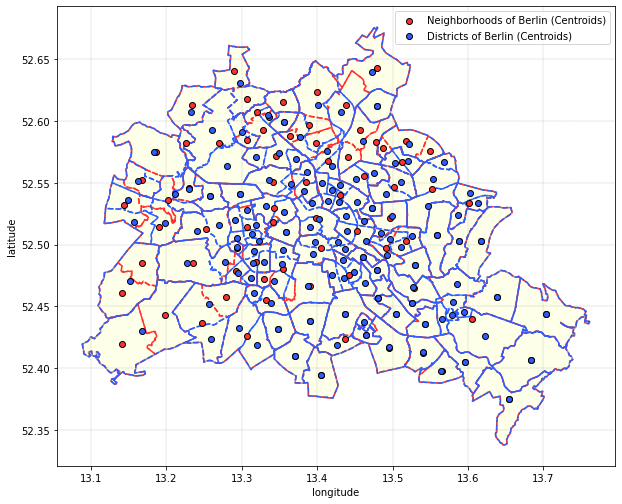

In [12]:
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(1, 1, 1)
ax.set_aspect('equal')

gdf_Borough.plot(ax=ax, facecolor="#FCFFCA",alpha=.4, edgecolor='#000000',linewidth=1.5)
gdf_Neighborhood.plot(ax=ax, facecolor="none", edgecolor="#FF3030",linestyle='--', linewidth=1.5)
gdf_District_Area.plot(ax=ax, facecolor="none", edgecolor='#305CFF',linestyle='--',linewidth=1.5)

xdataN = gdf_Neighborhood["lon"].values.tolist()
ydataN = gdf_Neighborhood["lat"].values.tolist()
ax.scatter(xdataN,ydataN,color='#FF3030', edgecolor="black",label="Neighborhoods of Berlin (Centroids)")
xdataD = gdf_District_Area["lon"].values.tolist()
ydataD = gdf_District_Area["lat"].values.tolist()
ax.scatter(xdataD,ydataD,color='#305CFF', edgecolor="black",label="Districts of Berlin (Centroids)")

ax.set_xlabel('longitude')
ax.set_ylabel('latitude')
ax.grid(color='grey', linestyle='--', linewidth=0.25)
plt.legend()
plt.show();

It is visible that for the southeast of Berlin both (neigborhoods and district areas) showing more or less the same boundary, but this is changing for the other parts of Berlin quite significantly. Nevertheless are both parts (neighborhoods and district regions) quite interesting. In the following part the geographical situation is covered in more detail.

### Average Income of the Boroughs
The first thing to check is the situation of the net income of the households in the different boroughs of Berlin. Before importing the data (from 2018) it was cleaned and formatted as a .csv UTF-8 file type for easier handling. The dataframe shows the housholds mean net income and also the average income of the borough as well as the amount of inhabitants. The top 3 boroughs with the highest average income are *Steglitz-Zehlendorf"*, *"Pankow"* and *Charlottenburg-Wilmersdorf"*. The boroughs with the lowest average income are *"Spandau", *"Lichtenberg" and *"Neukölln"*. Via the *folium* package this situation can also be shown on a map. Here all boroughs with their respective neighborhood positions are shown and the colormap indicates the average household income. 

In [13]:
# The Data is gathered from the https://www.statistik-berlin-brandenburg.de for the year 2018
Data_income = Income_Data.copy()
income_average = Income_Data.columns[1:]
income_average = income_average.str.replace(" €","")
income_average = income_average.values.astype("float")
# for loop to multiply the columns (starting with the second one Data_income.iloc[:,1:].columns) and index l=0 for the income average
l=0
for n in Data_income.iloc[:,1:].columns:
    Data_income[n] = Data_income[n]*1e3*income_average[l]
    l=l+1    
Data_income["sum_household_income"] = Data_income.iloc[:,1:].sum(axis=1)
Data_income["sum_population"] = Income_Data.iloc[:,1:].sum(axis=1)*1e3
Data_income["average_household_income"] = Data_income["sum_household_income"]/Data_income["sum_population"]
#Data_income.head(5)

In [14]:
move_columns(Data_income.sort_values(by="average_household_income",ascending=False),1,3).head(3)

,BOROUGH,sum_household_income,sum_population,average_household_income,800 €,1000 €,1200 €,1400 €,1600 €,1850 €,2150 €,2450 €,2750 €,3050 €,3400 €,3800 €,4250 €,4750 €,5250 €,5750 €,6750 €,8750 €,14000 €
5,Steglitz-Zehlendorf,1.080980e+09,287300.0,3762.547859,8000000.0,9800000.0,12120000.0,20300000.0,21120000.0,38295000.0,44720000.0,47775000.0,39325000.0,44530000.0,63920000.0,55100000.0,92225000.0,87875000.0,71400000.0,50025000.0,152550000.0,129500000.0,92400000.0
2,Pankow,1.380050e+09,392000.0,3520.535714,8400000.0,11000000.0,15600000.0,19180000.0,33760000.0,57535000.0,61490000.0,70070000.0,67650000.0,69540000.0,82620000.0,108680000.0,136850000.0,115900000.0,99225000.0,70150000.0,180900000.0,171500000.0,0.0
3,Charlottenburg-Wilmersdorf,1.100095e+09,315800.0,3483.518049,11760000.0,14100000.0,20400000.0,23100000.0,26880000.0,48840000.0,46225000.0,48020000.0,50875000.0,65880000.0,66980000.0,59660000.0,90525000.0,69825000.0,67200000.0,37375000.0,103950000.0,122500000.0,126000000.0


In [15]:
move_columns(Data_income.sort_values(by="average_household_income",ascending=False),1,3).tail(3)

,BOROUGH,sum_household_income,sum_population,average_household_income,800 €,1000 €,1200 €,1400 €,1600 €,1850 €,2150 €,2450 €,2750 €,3050 €,3400 €,3800 €,4250 €,4750 €,5250 €,5750 €,6750 €,8750 €,14000 €
4,Spandau,611045000.0,227400.0,2687.093228,7840000.0,10600000.0,13200000.0,20580000.0,21120000.0,50690000.0,47085000.0,45080000.0,50600000.0,41175000.0,48280000.0,54720000.0,68000000.0,37050000.0,47775000.0,0.0,47250000.0,0.0,0.0
10,Lichtenberg,725340000.0,274800.0,2639.519651,10960000.0,11400000.0,17760000.0,27860000.0,30720000.0,49765000.0,62565000.0,57330000.0,57750000.0,48800000.0,69700000.0,61180000.0,51425000.0,55100000.0,36750000.0,31050000.0,45225000.0,0.0,0.0
7,Neukoelln,798205000.0,312500.0,2554.256000,13520000.0,19000000.0,19680000.0,31780000.0,31520000.0,51060000.0,70520000.0,75215000.0,55825000.0,72285000.0,75480000.0,56620000.0,82025000.0,53675000.0,39375000.0,0.0,50625000.0,0.0,0.0


In [16]:
gdf_Borough_income = gdf_Borough[["BOROUGH","geometry","lat","lon"]].merge(Data_income[["BOROUGH","average_household_income","sum_population"]], left_on='BOROUGH', right_on="BOROUGH", how='left')
#move_columns(gdf_Borough_income.sort_values(by="average_household_income",ascending=False),1,2).head(5)

In [17]:
map_berlin = folium.Map(location=[latitude, longitude], zoom_start=11)

map_berlin.choropleth(
    geo_data=gdf_Borough_income,
    name='Income',
    data=Data_income,
    columns=['BOROUGH', 'average_household_income'],
    fill_color='YlOrRd',
    bins=9,
    key_on='feature.properties.BOROUGH',
    legend_name='Average Household Income of the Boroughs'
) 

for lat, lon, NEIGBORHOOD, BOROUGH in zip(gdf_Neighborhood['lat'],
                                          gdf_Neighborhood['lon'],
                                          gdf_Neighborhood['NEIGHBORHOOD'],
                                          gdf_Neighborhood['BOROUGH']):
    label = '{}, {} '.format(NEIGBORHOOD, BOROUGH)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=10,
        popup=label,
        color='black',
        fill=True,
        fill_color='#f8e7a8',
        fill_opacity=.8,
        parse_html=False).add_to(map_berlin)  
    
for lat, lon, BOROUGH, INCOME, POPULATION in zip(gdf_Borough_income['lat'],
                                                 gdf_Borough_income['lon'],
                                                 gdf_Borough_income['BOROUGH'],
                                                 gdf_Borough_income['average_household_income'],
                                                 gdf_Borough_income['sum_population']):
    label = '{}, Income: {} EUR, POP: {}'.format(BOROUGH,round(INCOME,2),int(POPULATION))
    label = folium.Popup(label, parse_html=True)
    folium.Marker(
        [lat, lon],
        radius=7,
        popup=label,
        icon = folium.Icon(color='green'),
        parse_html=False).add_to(map_berlin)  
    
map_berlin

### Population of the different District Areas
To display the amount of inhabitants of the district areas the following map was created. The colormap indicates this amount via the colorcode. The district areas with the most inhabitants are as expected close to the center of Berlin and are mainly "*Tempelhofer Vorstadt*", "*Tempelhof*" and "*Alexanderplatz*".

In [18]:
gdf_District_crime_pop_District_Area_reduced = gdf_District_crime_pop_District_Area[["LOR_KEY","DISTRICT_AREA","geometry","POPULATION"]]
move_columns(gdf_District_crime_pop_District_Area_reduced.sort_values(by="POPULATION",ascending=False),1,3).head(3)

,LOR_KEY,DISTRICT_AREA,geometry,POPULATION
11,020202,Tempelhofer Vorstadt,"POLYGON ((13.42023 52.49616, 13.41974 52.49620...",65647
71,070404,Tempelhof,"POLYGON ((13.36264 52.44415, 13.36275 52.44421...",65094
2,010113,Alexanderplatz,"POLYGON ((13.40382 52.50809, 13.40404 52.50799...",57883


In [19]:
map_berlin = folium.Map(location=[latitude, longitude], zoom_start=11)



map_berlin.choropleth(
    geo_data=gdf_District_crime_pop_District_Area_reduced,
    name='POPULATION',
    data=gdf_District_crime_pop_District_Area_reduced,
    columns=['DISTRICT_AREA', 'POPULATION'],
    fill_color='YlOrRd',
    fill_opacity=.6,
    bins=9,
    key_on='feature.properties.DISTRICT_AREA',
    legend_name='Population of the Districts-Area'
)

for lat, lon, DISTRICT_AREA, BOROUGH, POPULATION in zip(gdf_District_crime_pop_District_Area['lat'],
                                                         gdf_District_crime_pop_District_Area['lon'],
                                                         gdf_District_crime_pop_District_Area['DISTRICT_AREA'],
                                                         gdf_District_crime_pop_District_Area['BOROUGH'],
                                                         gdf_District_crime_pop_District_Area['POPULATION']):
    label = '{}, {}, Population: {} '.format(DISTRICT_AREA, BOROUGH,POPULATION)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=7,
        popup=label,
        color='black',
        fill=True,
        fill_color='#f8e7a8',
        fill_opacity=.8,
        parse_html=False).add_to(map_berlin)
    
for lat, lon, BOROUGH, INCOME, POPULATION in zip(gdf_Borough_income['lat'],
                                                 gdf_Borough_income['lon'],
                                                 gdf_Borough_income['BOROUGH'],
                                                 gdf_Borough_income['average_household_income'],
                                                 gdf_Borough_income['sum_population']):
    label = '{}, Income: {} EUR, POP: {}'.format(BOROUGH,round(INCOME,2),int(POPULATION))
    label = folium.Popup(label, parse_html=True)
    folium.Marker(
        [lat, lon],
        radius=7,
        popup=label,
        icon = folium.Icon(color='green'),
        parse_html=False).add_to(map_berlin)   
    
style = {'fillColor': 'None', 'color': '#005295'}    
folium.GeoJson(gdf_Borough_income, style_function=lambda x:style).add_to(map_berlin)

map_berlin

### Crime Count of the City
To investigate the crime rate first of all the HZ-Index can be shown on the map (colorcoding). 

In [20]:
Crime_reduced = pd.DataFrame(gdf_District_crime_pop_District_Area[["LOR_KEY","DISTRICT_AREA","geometry","BOROUGH","POPULATION","CRIME_COUNT","CRIME_per_100000_POP"]])
Crime_reduced = Crime_reduced.astype({"CRIME_per_100000_POP":"int"})

In [21]:
map_berlin = folium.Map(location=[latitude, longitude], zoom_start=11)

gdf_District_crime_pop_District_Area_reduced = gdf_District_crime_pop_District_Area[["LOR_KEY","DISTRICT_AREA","geometry","CRIME_per_100000_POP"]]

map_berlin.choropleth(
    geo_data=gdf_District_crime_pop_District_Area_reduced,
    name='CRIME',
    data=gdf_District_crime_pop_District_Area_reduced,
    columns=['DISTRICT_AREA', 'CRIME_per_100000_POP'],
    fill_color='YlOrRd',
    fill_opacity=.6,
    bins=9,
    key_on='feature.properties.DISTRICT_AREA',
    legend_name='Crimes per 100000 locals (HZ-Inedx)'
)

for lat, lon, DISTRICT_AREA, BOROUGH, CRIME_COUNT, POPULATION in zip(gdf_District_crime_pop_District_Area['lat'],
                                                                     gdf_District_crime_pop_District_Area['lon'],
                                                                     gdf_District_crime_pop_District_Area['DISTRICT_AREA'],
                                                                     gdf_District_crime_pop_District_Area['BOROUGH'],
                                                                     gdf_District_crime_pop_District_Area['CRIME_COUNT'],
                                                                     gdf_District_crime_pop_District_Area['POPULATION']):
    label = '{}, {}, Crimes: {}, Population: {} '.format(DISTRICT_AREA, BOROUGH,CRIME_COUNT,POPULATION)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=7,
        popup=label,
        color='black',
        fill=True,
        fill_color='#f8e7a8',
        fill_opacity=.8,
        parse_html=False).add_to(map_berlin)
    
for lat, lon, BOROUGH, INCOME, POPULATION in zip(gdf_Borough_income['lat'],
                                                 gdf_Borough_income['lon'],
                                                 gdf_Borough_income['BOROUGH'],
                                                 gdf_Borough_income['average_household_income'],
                                                 gdf_Borough_income['sum_population']):
    label = '{}, Income: {} EUR, POP: {}'.format(BOROUGH,round(INCOME,2),int(POPULATION))
    label = folium.Popup(label, parse_html=True)
    folium.Marker(
        [lat, lon],
        radius=7,
        popup=label,
        icon = folium.Icon(color='green'),
        parse_html=False).add_to(map_berlin)   
    
style = {'fillColor': 'None', 'color': '#005295'}    
folium.GeoJson(gdf_Borough_income, style_function=lambda x:style).add_to(map_berlin)

map_berlin

___
With a closer look on the district area of "*Forst Grunewald*" (*Charlottenburg-Wilmersdorf*) with only 105 crimes it has also the highest HZ-Index. This is far from right and since there are only 68 inhabitants this index is not usefull for this district here. Therefore the row has either to be dropped from the data frame or more simply the HZ-Index is set to a NaN value. The easiest way to index the row of "*Fort Grunewald*" is via the LOR-Key of the district region. In the following lines the HZ-Index of this area was set to a NaN-value. After skipping this area the three main crime hotspots are indicated as: "*Regierungsviertel*", "*Kurfürstendamm*" and "*Tiergarten Süd*". As expected are all three areas close to the center of Berlin.

In [22]:
move_columns(Crime_reduced.sort_values(by="CRIME_per_100000_POP",ascending=False),2,4).head(3)

,LOR_KEY,DISTRICT_AREA,BOROUGH,POPULATION,CRIME_COUNT,CRIME_per_100000_POP,geometry
50,040617,Forst Grunewald,Charlottenburg-Wilmersdorf,68,105,154411,"POLYGON ((13.26065 52.48939, 13.26056 52.48944..."
1,010112,Regierungsviertel,Mitte,12742,9146,71778,"POLYGON ((13.37686 52.51964, 13.37686 52.51947..."
42,040309,Kurfuerstendamm,Charlottenburg-Wilmersdorf,15522,8120,52312,"POLYGON ((13.30748 52.49987, 13.30812 52.49994..."


In [23]:
Crime_reduced.loc[Crime_reduced["LOR_KEY"] == "040617", ["CRIME_per_100000_POP"]] = np.nan
move_columns(Crime_reduced.sort_values(by="CRIME_per_100000_POP",ascending=False),2,4).head(3)

,LOR_KEY,DISTRICT_AREA,BOROUGH,POPULATION,CRIME_COUNT,CRIME_per_100000_POP,geometry
1,010112,Regierungsviertel,Mitte,12742,9146,71778.0,"POLYGON ((13.37686 52.51964, 13.37686 52.51947..."
42,040309,Kurfuerstendamm,Charlottenburg-Wilmersdorf,15522,8120,52312.0,"POLYGON ((13.30748 52.49987, 13.30812 52.49994..."
0,010111,Tiergarten Sued,Mitte,14985,5171,34507.0,"POLYGON ((13.36953 52.49887, 13.37036 52.49951..."


In [24]:
map_berlin = folium.Map(location=[latitude, longitude], zoom_start=11)

gdf_District_crime_pop_District_Area_reduced = gdf_District_crime_pop_District_Area[["LOR_KEY","DISTRICT_AREA","geometry","CRIME_per_100000_POP"]]
gdf_District_crime_pop_District_Area_reduced.loc[gdf_District_crime_pop_District_Area_reduced["LOR_KEY"] == "040617", ["CRIME_per_100000_POP"]] = np.nan

map_berlin.choropleth(
    geo_data=gdf_District_crime_pop_District_Area_reduced,
    name='CRIME',
    data=gdf_District_crime_pop_District_Area_reduced,
    columns=['DISTRICT_AREA', 'CRIME_per_100000_POP'],
    fill_color='YlOrRd',
    fill_opacity=.6,
    bins=9,
    key_on='feature.properties.DISTRICT_AREA',
    legend_name='Crimes per 100000 locals '
)

for lat, lon, DISTRICT_AREA, BOROUGH, CRIME_COUNT, CRIME_POP in zip(gdf_District_crime_pop_District_Area['lat'],
                                                                    gdf_District_crime_pop_District_Area['lon'],
                                                                    gdf_District_crime_pop_District_Area['DISTRICT_AREA'],
                                                                    gdf_District_crime_pop_District_Area['BOROUGH'],
                                                                    gdf_District_crime_pop_District_Area['CRIME_COUNT'],
                                                                    gdf_District_crime_pop_District_Area['CRIME_per_100000_POP']):
    label = '{}, {}, Crimes: {}, HZ-Index: {} '.format(DISTRICT_AREA, BOROUGH,CRIME_COUNT,int(CRIME_POP))
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=7,
        popup=label,
        color='black',
        fill=True,
        fill_color='#f8e7a8',
        fill_opacity=0.8,
        parse_html=False).add_to(map_berlin)
    
for lat, lon, BOROUGH, INCOME, POPULATION in zip(gdf_Borough_income['lat'],
                                                 gdf_Borough_income['lon'],
                                                 gdf_Borough_income['BOROUGH'],
                                                 gdf_Borough_income['average_household_income'],
                                                 gdf_Borough_income['sum_population']):
    label = '{}, Income: {} EUR, POP: {}'.format(BOROUGH,round(INCOME,2),int(POPULATION))
    label = folium.Popup(label, parse_html=True)
    folium.Marker(
        [lat, lon],
        radius=7,
        popup=label,
        icon = folium.Icon(color='green'),
        parse_html=False).add_to(map_berlin)   

style = {'fillColor': 'None', 'color': '#005295'}    
folium.GeoJson(gdf_Borough_income, style_function=lambda x:style).add_to(map_berlin)    
    
map_berlin

After skipping the value of "*Fort Grunewald*" it is more clear that the inner city has the highest HZ-index values.

### Crime Index and Population Normalization
As no one can expect to live in an area with a high amount of ihabitants and a low crime index there has to be a method for getting the best mixture. To determine the best mixture of a low crime index and a vital, attractive and lively area first of all the crime index and the population of the district areas were normalized within their min and max values.

In [25]:
gdf_District_crime_pop_District_Area["BOROUGH_KEY"] = gdf_District_crime_pop_District_Area["LOR_KEY"].str[:2]
gdf_District_crime_pop_District_Area.loc[gdf_District_crime_pop_District_Area["LOR_KEY"] == "040617", ["CRIME_per_100000_POP"]] = np.nan

In [26]:
gdf_District_crime_pop_District_Area["BOROUGH_KEY"] = gdf_District_crime_pop_District_Area["LOR_KEY"].str[:2]
gdf_District_crime_pop_District_Area=move_columns(move_columns(gdf_District_crime_pop_District_Area,0,1),4,3)

In [27]:
normalize_min_max(gdf_District_crime_pop_District_Area,"POPULATION")
normalize_min_max(gdf_District_crime_pop_District_Area,"CRIME_per_100000_POP")
move_columns(gdf_District_crime_pop_District_Area,7,2).sort_values(by="normCRIME_per_100000_POP",ascending=False).head(3)

,BOROUGH_KEY,LOR_KEY,DISTRICT_AREA,BOROUGH,CRIME_COUNT,POPULATION,CRIME_per_100000_POP,normPOPULATION,normCRIME_per_100000_POP,geometry,points,lat,lon
1,01,010112,Regierungsviertel,Mitte,9146,12742,71778.370742,0.193263,1.000000,"POLYGON ((13.37686 52.51964, 13.37686 52.51947...",POINT (13.39064 52.51416),52.514158,13.390642
42,04,040309,Kurfuerstendamm,Charlottenburg-Wilmersdorf,8120,15522,52312.846283,0.235655,0.716130,"POLYGON ((13.30748 52.49987, 13.30812 52.49994...",POINT (13.32293 52.50288),52.502885,13.322935
0,01,010111,Tiergarten Sued,Mitte,5171,14985,34507.841175,0.227466,0.456476,"POLYGON ((13.36953 52.49887, 13.37036 52.49951...",POINT (13.35819 52.51046),52.510455,13.358192


The normalization is useful to choose those districts that have a low crime index but also a high amount of inhabitants. To choose the best mixture of both two factors (*"crime_factor"* and *"population_factor"*) were defined and all the areas that are matching these predefined conditions were extracted. This first step was done a district area predefinition in order to decrease the amount of Foursquare API calls.

In [28]:
crime_pop_reduced = gdf_District_crime_pop_District_Area
crime_factor=0.4
population_factor=0.6
crime_pop_reduced = crime_pop_reduced[(crime_pop_reduced['normCRIME_per_100000_POP']<=crime_factor) & (crime_pop_reduced['normPOPULATION']>=population_factor)]
print("{} Districts are matching a lower crime factor of {} and a higher population factor of {} ".format(crime_pop_reduced.shape[0],crime_factor,population_factor))
crime_pop_reduced.sort_values(by="CRIME_per_100000_POP").head(3)

25 Districts are matching a lower crime factor of 0.4 and a higher population factor of 0.6 


,BOROUGH_KEY,LOR_KEY,DISTRICT_AREA,BOROUGH,CRIME_COUNT,POPULATION,CRIME_per_100000_POP,geometry,points,lat,lon,normPOPULATION,normCRIME_per_100000_POP
84,08,080410,Rudow,Neukoelln,2543,43941,5787.305705,"POLYGON ((13.51303 52.40105, 13.51354 52.40115...",POINT (13.49511 52.41714),52.417138,13.495112,0.669010,0.037638
61,06,060102,Albrechtstrasse,Steglitz-Zehlendorf,3104,53582,5792.990183,"POLYGON ((13.31543 52.45330, 13.31553 52.45326...",POINT (13.33897 52.45302),52.453021,13.338972,0.816023,0.037721
74,07,070707,Lichtenrade,Tempelhof-Schoeneberg,3026,51955,5824.271004,"POLYGON ((13.38239 52.38832, 13.38342 52.38836...",POINT (13.40448 52.39449),52.394487,13.404481,0.791214,0.038178


In [29]:
map_berlin = folium.Map(location=[latitude, longitude], zoom_start=11)

crime_pop_reduced_red = crime_pop_reduced[["LOR_KEY","DISTRICT_AREA","geometry","CRIME_per_100000_POP"]]

map_berlin.choropleth(
    geo_data=crime_pop_reduced_red,
)

for lat, lon, DISTRICT_AREA, BOROUGH in zip(gdf_District_crime_pop_District_Area['lat'],
                                            gdf_District_crime_pop_District_Area['lon'],
                                            gdf_District_crime_pop_District_Area['DISTRICT_AREA'],
                                            gdf_District_crime_pop_District_Area['BOROUGH']):
    label = '{}, {}'.format(DISTRICT_AREA, BOROUGH)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=7,
        popup=label,
        color='black',
        fill=True,
        fill_color='#f8e7a8',
        fill_opacity=0.8,
        parse_html=False).add_to(map_berlin)
    
for lat, lon, BOROUGH, INCOME, POPULATION in zip(gdf_Borough_income['lat'],
                                                 gdf_Borough_income['lon'],
                                                 gdf_Borough_income['BOROUGH'],
                                                 gdf_Borough_income['average_household_income'],
                                                 gdf_Borough_income['sum_population']):
    label = '{}, Income: {} EUR, POP: {}'.format(BOROUGH,round(INCOME,2),int(POPULATION))
    label = folium.Popup(label, parse_html=True)
    folium.Marker(
        [lat, lon],
        radius=7,
        popup=label,
        icon = folium.Icon(color='green'),
        parse_html=False).add_to(map_berlin)   

style1 = {'fillColor': 'None', 'color': '#005295'}    
folium.GeoJson(gdf_Borough_income, style_function=lambda x:style1).add_to(map_berlin)    

map_berlin

### Foursquare Data for Determination of a Lively and Save District Area
Since a predefined choice of some district areas was made still these district areas have to be compared towards each other in order to decide where the best district area for a lively region is. For this point the venues of the district areas are obtained via the "*Foursquare API*". All results can then be shown on a map for the different district areas.

In [30]:
CLIENT_ID = '<CLIENT_ID>' # your Foursquare ID
CLIENT_SECRET = '<CLIENT_SECRET>' # your Foursquare Secret
VERSION = '20200720' # Foursquare API version

#print('Your credentails:')
#print('CLIENT_ID: ' + CLIENT_ID)
#print('CLIENT_SECRET:' + CLIENT_SECRET)

In [31]:
lat_lon=pd.DataFrame(columns=["Name","lat","lon"],)
for idx,l in enumerate(list(crime_pop_reduced.index)):

    crime_pop_reduced_lat = crime_pop_reduced.loc[l, 'lat'] # neighborhood latitude value
    crime_pop_reduced_lon = crime_pop_reduced.loc[l, 'lon'] # neighborhood longitude value

    crime_pop_reduced_name = crime_pop_reduced.loc[l, 'DISTRICT_AREA'] # neighborhood name
    
    lat_lon.loc[idx]=[crime_pop_reduced_name,crime_pop_reduced_lat,crime_pop_reduced_lon]
    print('Latitude and longitude values of {} are {}, {}.'.format(crime_pop_reduced_name,crime_pop_reduced_lat,crime_pop_reduced_lon))

Latitude and longitude values of Moabit West are 52.53080564973236, 13.332154152275312.
Latitude and longitude values of Moabit Ost are 52.52626425077101, 13.355330374183856.
Latitude and longitude values of Brunnenstr. Nord are 52.542899836601265, 13.382889877309557.
Latitude and longitude values of Parkviertel are 52.5525065373179, 13.335584406019752.
Latitude and longitude values of Wedding Zentrum are 52.549195947543225, 13.36495894479807.
Latitude and longitude values of Suedliche Friedrichstadt are 52.50223215570544, 13.39746719788616.
Latitude and longitude values of Tempelhofer Vorstadt are 52.492006317302575, 13.39403967842771.
Latitude and longitude values of Frankfurter Allee Sued FK are 52.502495869917055, 13.46505936737791.
Latitude and longitude values of Falkenhagener Feld are 52.550956160465915, 13.162556803557763.
Latitude and longitude values of Albrechtstrasse are 52.4530207529719, 13.338972000661153.
Latitude and longitude values of Lankwitz are 52.431869723589195, 

In [32]:
Berlin_venues = getVenues(lat_lon["Name"],lat_lon["lat"],lat_lon["lon"],1000,100)
print('{} venues were returned by Foursquare.'.format(Berlin_venues.shape[0]))
Replacements = ["Venue"]
replace_characters(Berlin_venues,Replacements)

1497 venues were returned by Foursquare.


In [33]:
Berlin_venues.head(5)

,DISTRICT_AREA,DISTRICT_Latitude,DISTRICT_Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Moabit West,52.530806,13.332154,Einer dieser Tage,52.532388,13.331733,Café
1,Moabit West,52.530806,13.332154,Garcia Kaffeebar,52.527668,13.330624,Coffee Shop
2,Moabit West,52.530806,13.332154,Kallasch &,52.532869,13.336736,Bar
3,Moabit West,52.530806,13.332154,Zentrum fuer Kunst und Urbanistik (ZK-U),52.533659,13.336372,Art Gallery
4,Moabit West,52.530806,13.332154,Hamberger,52.533230,13.332539,Market


In [34]:
map_berlin = folium.Map(location=[latitude, longitude], zoom_start=11)

crime_pop_reduced_red = crime_pop_reduced[["LOR_KEY","DISTRICT_AREA","geometry","CRIME_per_100000_POP"]]

map_berlin.choropleth(
    geo_data=crime_pop_reduced_red,
)

for lat, lon, DISTRICT_AREA, Venue in zip(Berlin_venues['Venue Latitude'],
                                            Berlin_venues['Venue Longitude'],
                                            Berlin_venues['Venue'],
                                            Berlin_venues['DISTRICT_AREA']):
    label = '{}, {}'.format(DISTRICT_AREA, Venue)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color='black',
        fill=True,
        fill_color='#FF5555',
        fill_opacity=0.8,
        parse_html=False).add_to(map_berlin)
    
style1 = {'fillColor': 'None', 'color': '#005295'}    
folium.GeoJson(gdf_Borough_income, style_function=lambda x:style1).add_to(map_berlin)    

map_berlin

___
To determine if a an area of interest is a lively one or not the venues in this regions were splitted via the *one-hot-encoding* method and are grouped with respect to the district area.

In [35]:
#Berlin_venues.groupby('DISTRICT_AREA').count()

In [36]:
# one hot encoding
Berlin_venues_onehot = pd.get_dummies(Berlin_venues[['Venue Category']], prefix="", prefix_sep="")
Berlin_venues_onehot['DISTRICT_AREA'] = Berlin_venues['DISTRICT_AREA'] 
fixed_columns = [Berlin_venues_onehot.columns[-1]] + list(Berlin_venues_onehot.columns[:-1])
Berlin_venues_onehot = Berlin_venues_onehot[fixed_columns]
Group_Berlin = Berlin_venues_onehot.groupby("DISTRICT_AREA").sum().reset_index()
Group_Berlin.head(5)

,DISTRICT_AREA,Adult Boutique,African Restaurant,American Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Austrian Restaurant,Auto Dealership,Automotive Shop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Bath House,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Shop,Bistro,Bookstore,Boutique,Bowling Alley,Breakfast Spot,Brewery,Burger Joint,Burrito Place,Bus Stop,Café,Camera Store,Candy Store,Caribbean Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Community Center,Convenience Store,Costume Shop,Coworking Space,Creperie,Cultural Center,Cupcake Shop,Currywurst Joint,Cycle Studio,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Dive Bar,Dog Run,Doner Restaurant,Donut Shop,Drugstore,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,Ethiopian Restaurant,Event Space,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop,Food Court,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Halal Restaurant,Historic Site,History Museum,Hobby Shop,Hockey Field,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Indoor Play Area,Intersection,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Juice Bar,Karaoke Bar,Kebab Restaurant,Kofte Place,Korean Restaurant,Lake,Laundromat,Lebanese Restaurant,Light Rail Station,Liquor Store,Market,Massage Studio,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Motorcycle Shop,Movie Theater,Museum,Music Store,Music Venue,Newsstand,Nightclub,Non-Profit,Organic Grocery,Other Nightlife,Other Repair Shop,Outdoor Sculpture,Pakistani Restaurant,Palace,Paper / Office Supplies Store,Park,Pastry Shop,Performing Arts Venue,Perfume Shop,Persian Restaurant,Peruvian Restaurant,Pet Store,Pharmacy,Photography Studio,Piano Bar,Pizza Place,Planetarium,Platform,Playground,Plaza,Pool,Pool Hall,Post Office,Pub,Record Shop,Recreation Center,Rental Car Location,Rest Area,Restaurant,Rock Club,Russian Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Seafood Restaurant,Shawarma Place,Shipping Store,Shopping Mall,Skate Park,Smoke Shop,Snack Place,Soccer Field,Soccer Stadium,South Indian Restaurant,Souvenir Shop,Spa,Spanish Restaurant,Sporting Goods Shop,Sports Bar,Squash Court,Stadium,Steakhouse,Storage Facility,Street Art,Supermarket,Sushi Restaurant,Swabian Restaurant,Syrian Restaurant,Szechuan Restaurant,Tapas Restaurant,Tattoo Parlor,Taverna,Tea Room,Tennis Court,Thai Restaurant,Theater,Theme Restaurant,Thrift / Vintage Store,Tibetan Restaurant,Tour Provider,Track,Trail,Train Station,Tram Station,Trattoria/Osteria,Tree,Turkish Restaurant,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Video Store,Vietnamese Restaurant,Volleyball Court,Waterfront,Wine Bar,Wine Shop,Women's Store,Yemeni Restaurant,Yoga Studio
0,Albrechtstrasse,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,2,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,2,0,1,0,0,1,0,0,0,0,0,0,0,0
1,Britz

___
In the next step it was necessary to merge the grouped venues data together with the crime index and population data.

In [37]:
#crime_pop_reduced.head(2)

In [38]:
#Group_Berlin.head(2)

In [39]:
tmp1 = Group_Berlin
tmp2 = crime_pop_reduced[["DISTRICT_AREA","POPULATION","CRIME_per_100000_POP"]]
Group_Berlin_crime_pop = pd.merge(tmp1, tmp2, on=['DISTRICT_AREA', 'DISTRICT_AREA'])
Group_Berlin_crime_pop = move_columns(Group_Berlin_crime_pop,1,2)
Group_Berlin_crime_pop.head(5)

,DISTRICT_AREA,POPULATION,CRIME_per_100000_POP,Adult Boutique,African Restaurant,American Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Austrian Restaurant,Auto Dealership,Automotive Shop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Bath House,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Shop,Bistro,Bookstore,Boutique,Bowling Alley,Breakfast Spot,Brewery,Burger Joint,Burrito Place,Bus Stop,Café,Camera Store,Candy Store,Caribbean Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Community Center,Convenience Store,Costume Shop,Coworking Space,Creperie,Cultural Center,Cupcake Shop,Currywurst Joint,Cycle Studio,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Dive Bar,Dog Run,Doner Restaurant,Donut Shop,Drugstore,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,Ethiopian Restaurant,Event Space,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop,Food Court,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Halal Restaurant,Historic Site,History Museum,Hobby Shop,Hockey Field,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Indoor Play Area,Intersection,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Juice Bar,Karaoke Bar,Kebab Restaurant,Kofte Place,Korean Restaurant,Lake,Laundromat,Lebanese Restaurant,Light Rail Station,Liquor Store,Market,Massage Studio,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Motorcycle Shop,Movie Theater,Museum,Music Store,Music Venue,Newsstand,Nightclub,Non-Profit,Organic Grocery,Other Nightlife,Other Repair Shop,Outdoor Sculpture,Pakistani Restaurant,Palace,Paper / Office Supplies Store,Park,Pastry Shop,Performing Arts Venue,Perfume Shop,Persian Restaurant,Peruvian Restaurant,Pet Store,Pharmacy,Photography Studio,Piano Bar,Pizza Place,Planetarium,Platform,Playground,Plaza,Pool,Pool Hall,Post Office,Pub,Record Shop,Recreation Center,Rental Car Location,Rest Area,Restaurant,Rock Club,Russian Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Seafood Restaurant,Shawarma Place,Shipping Store,Shopping Mall,Skate Park,Smoke Shop,Snack Place,Soccer Field,Soccer Stadium,South Indian Restaurant,Souvenir Shop,Spa,Spanish Restaurant,Sporting Goods Shop,Sports Bar,Squash Court,Stadium,Steakhouse,Storage Facility,Street Art,Supermarket,Sushi Restaurant,Swabian Restaurant,Syrian Restaurant,Szechuan Restaurant,Tapas Restaurant,Tattoo Parlor,Taverna,Tea Room,Tennis Court,Thai Restaurant,Theater,Theme Restaurant,Thrift / Vintage Store,Tibetan Restaurant,Tour Provider,Track,Trail,Train Station,Tram Station,Trattoria/Osteria,Tree,Turkish Restaurant,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Video Store,Vietnamese Restaurant,Volleyball Court,Waterfront,Wine Bar,Wine Shop,Women's Store,Yemeni Restaurant,Yoga Studio
0,Albrechtstrasse,53582,5792.990183,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,2,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,1,0,0

___
The most common venues can than be shown for the different district areas.

In [40]:
tmp = Group_Berlin_crime_pop.drop(["POPULATION","CRIME_per_100000_POP"],axis=1)
Berlin_venues_list = most_common_venues(tmp,"DISTRICT_AREA",10)
Berlin_venues_list.head(3)

,DISTRICT_AREA,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Albrechtstrasse,Supermarket,Café,Chinese Restaurant,Park,Trattoria/Osteria,Pool,Bus Stop,Sandwich Place,Pub,Currywurst Joint
1,Britz,Supermarket,Bakery,Liquor Store,Fast Food Restaurant,Park,Palace,Soccer Field,Flower Shop,Food & Drink Shop,Stadium
2,Brunnenstr. Nord,Bakery,Supermarket,Vietnamese Restaurant,Café,Hotel,Italian Restaurant,Asian Restaurant,Garden,Coffee Shop,Bistro


### k-means Clustering
In order to decide now which region will be the best, the venue data is clustered via the *"KMeans"* module. To decide how many clusters should be used for clustering an elbow plot was prepared.

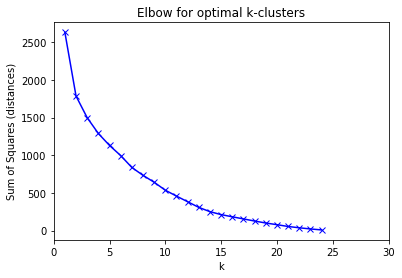

In [41]:
Berlin_kmeans_data = Group_Berlin_crime_pop
Berlin_kmeans_data_clustering=Berlin_kmeans_data.drop(["DISTRICT_AREA","POPULATION","CRIME_per_100000_POP"],axis=1)
elbow_calculation(Berlin_kmeans_data_clustering,30)

From this plot it is visible that k-values of 4-6 are maybe most suitable for the clustering. Therefore the number of clusters was set to 5 and the k-means clustering was performed.

In [42]:
cluster_num = 5
Berlin_kmeans_data_clustering = Berlin_kmeans_data.drop('DISTRICT_AREA', 1)
kmean_cluster = KMeans(n_clusters = cluster_num, random_state = 0).fit(Berlin_kmeans_data_clustering)
kmean_cluster

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=5, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=0, tol=0.0001, verbose=0)

In [43]:
try:
    Berlin_kmeans_data.insert(0,'Cluster_Labels', kmean_cluster.labels_)
except:
    Berlin_kmeans_data.drop("Cluster_Labels",axis=1,inplace=True)
    Berlin_kmeans_data.insert(0,'Cluster_Labels', kmean_cluster.labels_)

#Berlin_kmeans_data.head(5)

In [44]:
tmp1=Berlin_kmeans_data[["Cluster_Labels","DISTRICT_AREA","POPULATION","CRIME_per_100000_POP"]]
tmp2=Berlin_venues_list
tmp3=gdf_District_Area[["DISTRICT_AREA","lat","lon"]]
Berlin_final_data = pd.merge(tmp1,tmp2,on=['DISTRICT_AREA', 'DISTRICT_AREA'])
Berlin_final_data = pd.merge(Berlin_final_data,tmp3,on=['DISTRICT_AREA', 'DISTRICT_AREA'])

The cluster labels can be inserted after the k-means clustering with respect to the district area and the most common venues are shown in the following dataframe. The clusters and their position can be shown on a map.

In [45]:
Berlin_final_data.head(5)

,Cluster_Labels,DISTRICT_AREA,POPULATION,CRIME_per_100000_POP,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,lat,lon
0,3,Albrechtstrasse,53582,5792.990183,Supermarket,Café,Chinese Restaurant,Park,Trattoria/Osteria,Pool,Bus Stop,Sandwich Place,Pub,Currywurst Joint,52.453021,13.338972
1,2,Britz,43514,10922.921359,Supermarket,Bakery,Liquor Store,Fast Food Restaurant,Park,Palace,Soccer Field,Flower Shop,Food & Drink Shop,Stadium,52.443750,13.436754
2,4,Brunnenstr. Nord,39469,16248.194786,Bakery,Supermarket,Vietnamese Restaurant,Café,Hotel,Italian Restaurant,Asian Restaurant,Garden,Coffee Shop,Bistro,52.542900,13.382890
3,3,Drakestrasse,50385,6628.957031,Supermarket,Bakery,Bus Stop,Café,BBQ Joint,Italian Restaurant,Plaza,Drugstore,Hotel,Greek Restaurant,52.432348,13.296073
4,2,Falkenhagener Feld,42031,6552.306631,Liquor Store,Lake,Bus Stop,Café,Soccer Field,Snack Place,Park,Supermarket,Drugstore,Dumpling Restaurant,52.550956,13.162557


In [46]:
map_berlin = folium.Map(location=[latitude, longitude], zoom_start=11)

crime_pop_reduced_red = crime_pop_reduced[["LOR_KEY","DISTRICT_AREA","geometry","CRIME_per_100000_POP"]]

colors_array = cm.rainbow(np.linspace(0, 1, cluster_num))
rainbow = [colors.rgb2hex(i) for i in colors_array]

map_berlin.choropleth(
    geo_data=crime_pop_reduced_red
)

for lat, lon, DISTRICT_AREA, Cluster in zip(Berlin_final_data['lat'],
                                            Berlin_final_data['lon'],
                                            Berlin_final_data['DISTRICT_AREA'],
                                            Berlin_final_data['Cluster_Labels']):
    label = 'District: {}, Cluster: {}'.format(DISTRICT_AREA, Cluster)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=10,
        popup=label,
        color="black",#rainbow[Cluster-1],
        fill=True,
        fill_color=rainbow[Cluster-1],
        fill_opacity=0.8,
        parse_html=False).add_to(map_berlin)
    
style1 = {'fillColor': 'None', 'color': '#005295'}    
folium.GeoJson(gdf_Borough_income, style_function=lambda x:style1).add_to(map_berlin)    

map_berlin

___
To decide now which cluster includes the best district areas, the crime index and the population were plotted against the clusternumbers as boxplots.

Text(0.5, 0.98, 'Cluster Plotting')

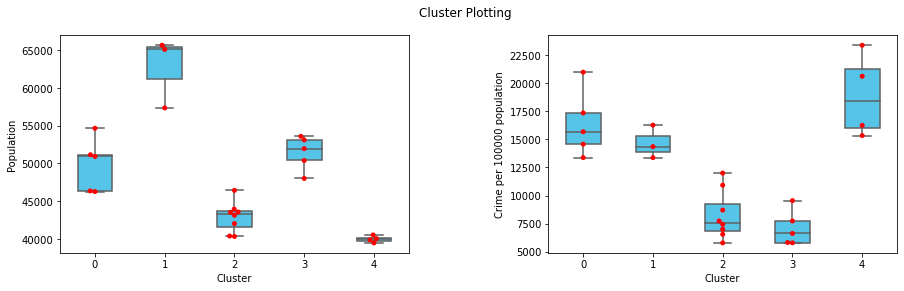

In [47]:
fig, axs = plt.subplots(1, 2, figsize=(15,4))
sns.boxplot(y='POPULATION', x='Cluster_Labels',data=Berlin_final_data,width=0.5,color="#3ED0FF",ax=axs[0])
sns.swarmplot(y='POPULATION', x='Cluster_Labels',data=Berlin_final_data,color="red",ax=axs[0])
axs[0].set_xlabel("Cluster")
axs[0].set_ylabel("Population")
sns.boxplot(y='CRIME_per_100000_POP', x='Cluster_Labels',data=Berlin_final_data,width=0.5,color="#3ED0FF",ax=axs[1])
sns.swarmplot(y='CRIME_per_100000_POP', x='Cluster_Labels',data=Berlin_final_data,color="red",ax=axs[1])
axs[1].set_xlabel("Cluster")
axs[1].set_ylabel("Crime per 100000 population")
fig.subplots_adjust(hspace=0.4, wspace=0.4)
fig.suptitle('Cluster Plotting')

### Choosing the Cluster
The clusters clearly show a dependency of the population and from the crime index. Let´s now assume that the cluster number 3 would be the most interesting one because we would have a mid range population in our region but also the median of the crime index is the lowest one of all. With the choosen cluster the geometry of the district regions (for plotting the ares) and the venues were extracted to show them in a Berlin map.

In [48]:
cluster_to_choose = 3
Berlin_final_data_choosen_districts = Berlin_final_data[Berlin_final_data["Cluster_Labels"]==cluster_to_choose]

In [49]:
Berlin_final_data_choosen_districts_geometry=gpd.GeoDataFrame(columns=crime_pop_reduced.columns)
for k in Berlin_final_data_choosen_districts["DISTRICT_AREA"]:
    d = crime_pop_reduced.loc[crime_pop_reduced["DISTRICT_AREA"]==k]
    Berlin_final_data_choosen_districts_geometry=Berlin_final_data_choosen_districts_geometry.append(d)

In [50]:
Berlin_venues_reduced=pd.DataFrame(columns=Berlin_venues.columns)
for k in Berlin_final_data_choosen_districts["DISTRICT_AREA"]:
    d = Berlin_venues.loc[Berlin_venues["DISTRICT_AREA"]==k]
    Berlin_venues_reduced=Berlin_venues_reduced.append(d)

In [51]:
#Berlin_final_data_choosen_districts_geometry

In [52]:
map_berlin = folium.Map(location=[latitude, longitude], zoom_start=11)

map_berlin.choropleth(
    geo_data=Berlin_final_data_choosen_districts_geometry[["DISTRICT_AREA","geometry","CRIME_per_100000_POP"]].set_crs("EPSG:4326"),
) 

for lat, lon, DISTRICT_AREA, Venue in zip(Berlin_venues_reduced['Venue Latitude'],
                                          Berlin_venues_reduced['Venue Longitude'],
                                          Berlin_venues_reduced['Venue'],
                                          Berlin_venues_reduced['DISTRICT_AREA']):
    label = '{}, {}'.format(DISTRICT_AREA, Venue)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=4,
        popup=label,
        color='black',
        fill=True,
        fill_color='#f8e7a8',
        fill_opacity=0.8,
        parse_html=False).add_to(map_berlin)
    
style1 = {'fillColor': 'None', 'color': '#005295'}    
folium.GeoJson(gdf_Borough_income, style_function=lambda x:style1).add_to(map_berlin)    

for lat, lon, BOROUGH, DISTRICT_AREA in zip(Berlin_final_data_choosen_districts_geometry['lat'],
                                            Berlin_final_data_choosen_districts_geometry['lon'],
                                            Berlin_final_data_choosen_districts_geometry['BOROUGH'],
                                            Berlin_final_data_choosen_districts_geometry['DISTRICT_AREA']):
    label = '{}, {}'.format(DISTRICT_AREA, BOROUGH)
    label = folium.Popup(label, parse_html=True)
    folium.Marker(
        [lat, lon],
        radius=7,
        popup=label,
        icon = folium.Icon(color='blue')
    ).add_to(map_berlin)
    
for lat, lon, BOROUGH, INCOME, POPULATION in zip(gdf_Borough_income['lat'],
                                                 gdf_Borough_income['lon'],
                                                 gdf_Borough_income['BOROUGH'],
                                                 gdf_Borough_income['average_household_income'],
                                                 gdf_Borough_income['sum_population']):
    label = '{}, Income: {} EUR, POP: {}'.format(BOROUGH,round(INCOME,2),int(POPULATION))
    label = folium.Popup(label, parse_html=True)
    folium.Marker(
        [lat, lon],
        radius=7,
        popup=label,
        icon = folium.Icon(color='green'),
        parse_html=False).add_to(map_berlin) 
map_berlin

The map shows every district area thats fits our choosen cluster (see also following dataframe).

In [53]:
Berlin_final_data_choosen_districts.head(5)

,Cluster_Labels,DISTRICT_AREA,POPULATION,CRIME_per_100000_POP,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,lat,lon
0,3,Albrechtstrasse,53582,5792.990183,Supermarket,Café,Chinese Restaurant,Park,Trattoria/Osteria,Pool,Bus Stop,Sandwich Place,Pub,Currywurst Joint,52.453021,13.338972
3,3,Drakestrasse,50385,6628.957031,Supermarket,Bakery,Bus Stop,Café,BBQ Joint,Italian Restaurant,Plaza,Drugstore,Hotel,Greek Restaurant,52.432348,13.296073
8,3,Lichtenrade,51955,5824.271004,Supermarket,Soccer Field,Bakery,Doner Restaurant,Light Rail Station,Restaurant,Gas Station,Mobile Phone Shop,Gym / Fitness Center,Plaza,52.394487,13.404481
10,3,Mariendorf,53106,7739.238504,Supermarket,Bank,German Restaurant,Pool,Bakery,Bus Stop,Steakhouse,Storage Facility,Motorcycle Shop,Chinese Restaurant,52.438506,13.390902
11,3,Marzahn Mitte,48008,9550.491585,Tram Station,Supermarket,Cultural Center,Shopping Mall,Park,Soccer Field,Fast Food Restaurant,Steakhouse,Miscellaneous Shop,Greek Restaurant,52.553200,13.553800


# Results
### Sum of Venues
For the next step the sum of venues in the respective choosen district areas could give an introduction how lively and how liveable the region can be. Therefore all choosen venues were summed to get an overall value of nearby venues in the district region. 

In [54]:
Berlin_venues_count = Berlin_kmeans_data
Berlin_venues_count = Berlin_venues_count[Berlin_venues_count["Cluster_Labels"]==cluster_to_choose]
try:
    Berlin_venues_count.drop("SUM_VENUES",axis=1,inplace=True)
except:
    pass
Berlin_venues_count["SUM_VENUES"] = Berlin_venues_count.iloc[:,4:].sum(axis=1)
Berlin_venues_count = move_columns(Berlin_venues_count.sort_values("SUM_VENUES",ascending=False),4,1)
Berlin_venues_count_list = pd.merge(Berlin_final_data_choosen_districts,Berlin_venues_count[["DISTRICT_AREA","SUM_VENUES"]],on=["DISTRICT_AREA","DISTRICT_AREA"])
Berlin_venues_count_list = move_columns(Berlin_venues_count_list.sort_values("SUM_VENUES",ascending=False),4,1)
Berlin_venues_count_list.reset_index(inplace=True)
Berlin_venues_count_list.drop("index",axis=1,inplace=True)
print("The top three relevant district areas are {}, {} and {}".format(Berlin_venues_count_list["DISTRICT_AREA"][0],
                                                                       Berlin_venues_count_list["DISTRICT_AREA"][1],
                                                                       Berlin_venues_count_list["DISTRICT_AREA"][2]))
Berlin_venues_count_list.head(3)

The top three relevant district areas are Albrechtstrasse, Lichtenrade and Mariendorf


,Cluster_Labels,DISTRICT_AREA,POPULATION,CRIME_per_100000_POP,SUM_VENUES,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,lat,lon
0,3,Albrechtstrasse,53582,5792.990183,31,Supermarket,Café,Chinese Restaurant,Park,Trattoria/Osteria,Pool,Bus Stop,Sandwich Place,Pub,Currywurst Joint,52.453021,13.338972
1,3,Lichtenrade,51955,5824.271004,28,Supermarket,Soccer Field,Bakery,Doner Restaurant,Light Rail Station,Restaurant,Gas Station,Mobile Phone Shop,Gym / Fitness Center,Plaza,52.394487,13.404481
2,3,Mariendorf,53106,7739.238504,28,Supermarket,Bank,German Restaurant,Pool,Bakery,Bus Stop,Steakhouse,Storage Facility,Motorcycle Shop,Chinese Restaurant,52.438506,13.390902


___
Because everybody has special interests what he/she needs most in an living area it is usefull to predefine these most important venues. Let´s say that the venues for a good living are the following ones: Chinese Restaurant, Café, Shopping Mall, Gas Station, Drugstore, Pharmacy, Grocery Store, Organic Grocery, Gym / Fitness Center, Supermarket, Bakery, German Restaurant. After the venue definition a reduced version of the venue count can be defined and investigated.

In [55]:
#Berlin_venues_count.iloc[:,5:].columns.values

In [56]:
important_columns = ["DISTRICT_AREA",
                     "POPULATION",
                     "CRIME_per_100000_POP", 
                     "Chinese Restaurant",
                     "Café",
                     "Shopping Mall",
                     "Gas Station",
                     "Drugstore",
                     "Pharmacy",
                     "Grocery Store",
                     "Organic Grocery",
                     "Gym / Fitness Center",
                     "Supermarket",
                     "Bakery",
                     "German Restaurant"]

In [57]:
Berlin_venues_count_reduced = Berlin_venues_count[important_columns]
try:
    Berlin_venues_count_reduced.drop("SUM_VENUES",axis=1,inplace=True)
except:
    pass
Berlin_venues_count_reduced["SUM_VENUES"] = Berlin_venues_count_reduced.iloc[:,3:].sum(axis=1)
Berlin_venues_count_reduced = move_columns(Berlin_venues_count_reduced.sort_values("SUM_VENUES",ascending=False),3,1)
tmp = Berlin_venues_count_reduced.drop(["POPULATION","CRIME_per_100000_POP","SUM_VENUES"],axis=1)
Berlin_venues_count_reduced_list = most_common_venues(tmp,"DISTRICT_AREA",10)
Berlin_venues_count_reduced_list = pd.merge(Berlin_venues_count_reduced[["DISTRICT_AREA","POPULATION","CRIME_per_100000_POP","SUM_VENUES"]],Berlin_venues_count_reduced_list, on=["DISTRICT_AREA","DISTRICT_AREA"])
Berlin_venues_count_reduced_list = Berlin_venues_count_reduced_list.sort_values(by="SUM_VENUES",ascending=False)
print("The top three relevant district areas are {}, {} and {}".format(Berlin_venues_count_reduced_list["DISTRICT_AREA"][0],
                                                                       Berlin_venues_count_reduced_list["DISTRICT_AREA"][1],
                                                                       Berlin_venues_count_reduced_list["DISTRICT_AREA"][2]))
Berlin_venues_count_reduced_list.head(3)

The top three relevant district areas are Lichtenrade, Albrechtstrasse and Mariendorf


,DISTRICT_AREA,POPULATION,CRIME_per_100000_POP,SUM_VENUES,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Lichtenrade,51955,5824.271004,12,Supermarket,Bakery,German Restaurant,Gym / Fitness Center,Pharmacy,Drugstore,Gas Station,Organic Grocery,Grocery Store,Shopping Mall
1,Albrechtstrasse,53582,5792.990183,11,Supermarket,Café,Chinese Restaurant,Bakery,Organic Grocery,Grocery Store,German Restaurant,Gym / Fitness Center,Pharmacy,Drugstore
2,Mariendorf,53106,7739.238504,9,Supermarket,German Restaurant,Bakery,Drugstore,Chinese Restaurant,Gym / Fitness Center,Organic Grocery,Grocery Store,Pharmacy,Gas Station


# Discussion and Conclusion
The results of this data investigation shows that it is possible to determine the most relevant district areas of Berlin for a relatively save and lively neighborhood to live in. After predefining areas with a low (normalized) crime index and high (normalized) population index, these regions could be used to obtain the necessary venues out of Foursquare. After clustering the data via the *KMeans* method from *sklearn* the clusters could be assigned. Plotting the crime index and the population against these clusters helped to investigate both factors and to make a decision which cluster would be the most interesting one. Finally the sum of venues and its reduced version showed which district area would be preferable to live in. In generel this method can help to identify the most relevent regions in a city, but since it is strongly dependent on the quality of the venue data, this data plays a crucial role. Upon investigation of the venue positions it is clear that for Berlin maybe many positions and datapoints are missing and therefore the reliability of the process is influenced. Nevertheless, this procedure is maybe a good starting point to investigate other cities as well. This investigation showed that it is possible to search for good areas to live inside a city with a focus upon crime, population and venues.